# SAYISAL GÖRÜNTÜ İŞLEME - ARA SINAV ÖDEVİ

## ISIC 2018 Deri Lezyonu Veri Seti Analizi

**Öğrenci:** Ali Ozan Özkul (254329026) 
**Veri Seti:** ISIC 2018 Skin Lesion Dataset  
**Teslim Tarihi:** Kasım 2025

---

Bu ödevde ISIC veri setindeki deri lezyonu görüntüleri üzerinde çeşitli görüntü işleme yöntemleri uyguladım. Tüm işlemleri hem RGB hem de gri tonlamalı (grayscale) görüntüler üzerinde denedim ve sonuçları karşılaştırdım.


## 1. VERİ SETİNİ YÜKLEME VE İNCELEME


### 1.1. Gerekli Kütüphanelerin Yüklenmesi

Öncelikle projede kullanacağım tüm Python kütüphanelerini import ediyorum.


In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
from PIL import Image
import warnings
warnings.filterwarnings('ignore')

sns.set_palette("husl")

print("✅ Tüm kütüphaneler başarıyla yüklendi!")
print(f"✅ OpenCV: {cv2.__version__}")
print(f"✅ NumPy: {np.__version__}")
print(f"✅ Pandas: {pd.__version__}")


✅ Tüm kütüphaneler başarıyla yüklendi!
✅ OpenCV: 4.12.0
✅ NumPy: 2.2.6
✅ Pandas: 2.3.3


### 1.2. Veri Setinin Sisteme Yüklenmesi

Klasördeki tüm görüntü dosyalarını tarayıp bir pandas DataFrame'ine aktarıyorum. Bu sayede görüntü yolları ve hastalık etiketlerini düzenli bir şekilde saklayabiliyorum.


In [ ]:
# Veri setimin bulunduğu klasör yolu
dataset_path = 'Skin cancer ISIC The International Skin Imaging Collaboration/Train'

# Görüntü yollarını ve etiketlerini tutacak listeler
image_paths = []
labels = []

# Her bir hastalık klasörünü dolaş
for class_name in os.listdir(dataset_path):
    class_path = os.path.join(dataset_path, class_name)
    if os.path.isdir(class_path):
        # Klasördeki her jpg dosyasını bul
        for img_name in os.listdir(class_path):
            if img_name.endswith('.jpg'):
                image_paths.append(os.path.join(class_path, img_name))
                labels.append(class_name)

# DataFrame oluştur
train_df = pd.DataFrame({
    'image_path': image_paths,
    'label': labels
})

print(f"Toplam {len(train_df)} adet görüntü yüklendi")
print("\nİlk birkaç satıra bakalım:")
train_df.head()


Toplam yüklenen görüntü sayısı: 2239

İlk 5 kayıt:


,image_path,label
0,Skin cancer ISIC The International Skin Imagin...,actinic keratosis
1,Skin cancer ISIC The International Skin Imagin...,actinic keratosis
2,Skin cancer ISIC The International Skin Imagin...,actinic keratosis
3,Skin cancer ISIC The International Skin Imagin...,actinic keratosis
4,Skin cancer ISIC The International Skin Imagin...,actinic keratosis


Sınıf bazında görüntü dağılımı:
label
pigmented benign keratosis    462
melanoma                      438
basal cell carcinoma          376
nevus                         357
squamous cell carcinoma       181
vascular lesion               139
actinic keratosis             114
dermatofibroma                 95
seborrheic keratosis           77
Name: count, dtype: int64


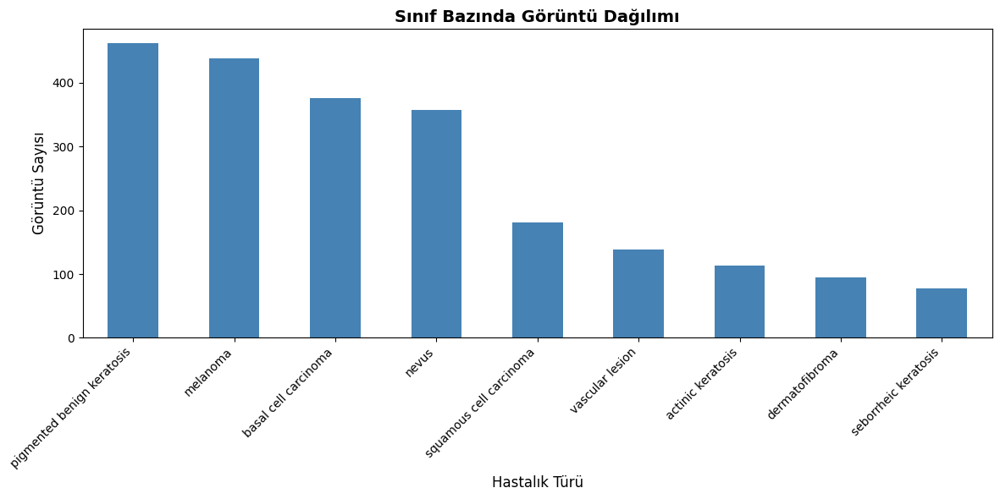

In [ ]:
# Her hastalık türünde kaç görüntü var?
print("Hastalık türlerine göre görüntü sayıları:")
class_distribution = train_df['label'].value_counts()
print(class_distribution)

# Bunu görselleştirelim
plt.figure(figsize=(12, 6))
class_distribution.plot(kind='bar', color='steelblue')
plt.title('Hastalık Türlerine Göre Görüntü Dağılımı', fontsize=14, fontweight='bold')
plt.xlabel('Hastalık Türü', fontsize=12)
plt.ylabel('Görüntü Sayısı', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


### 1.3. Görüntü Özelliklerini İnceleme

Şimdi görüntülerin teknik özelliklerine bakalım - boyutları ne, dosya büyüklükleri nasıl gibi.


=== GÖRÜNTÜ ÖZELLİKLERİ ===
Yükseklik - Min: 450px, Max: 2592px, Ort: 671.21px
Genişlik - Min: 600px, Max: 3872px, Ort: 898.28px
Kanal Sayısı: {3}
Dosya Boyutu - Min: 40.98KB, Max: 2274.90KB


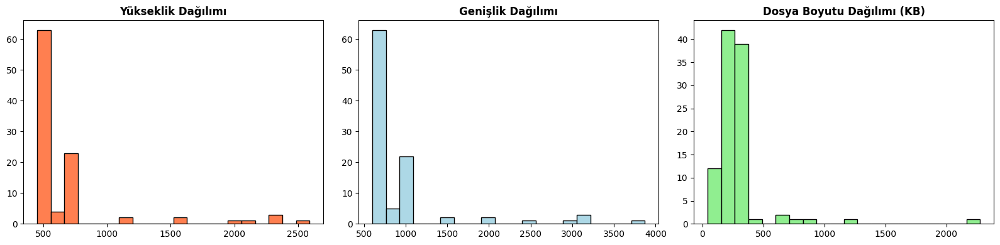


Analiz: Görüntülerin heterojen çözünürlüklere sahip olması, farklı kaynaklardan alınan medikal görüntülerde sıklıkla karşılaşılan bir özelliktir.


In [ ]:
# Rastgele 100 görüntü seçip özelliklerine bakalım
sample_size = min(100, len(train_df))
sample_indices = np.random.choice(len(train_df), sample_size, replace=False)

widths, heights, channels, file_sizes = [], [], [], []

for idx in sample_indices:
    img_path = train_df.iloc[idx]['image_path']
    img = cv2.imread(img_path)
    if img is not None:
        h, w, c = img.shape
        heights.append(h)
        widths.append(w)
        channels.append(c)
        file_sizes.append(os.path.getsize(img_path) / 1024)  # KB cinsinden

print("=== GÖRÜNTÜ ÖZELLİKLERİ ===")
print(f"Yükseklik - En küçük: {min(heights)}px, En büyük: {max(heights)}px, Ortalama: {np.mean(heights):.2f}px")
print(f"Genişlik - En küçük: {min(widths)}px, En büyük: {max(widths)}px, Ortalama: {np.mean(widths):.2f}px")
print(f"Kanal sayısı: {set(channels)} (RGB formatında)")
print(f"Dosya boyutu - En küçük: {min(file_sizes):.2f}KB, En büyük: {max(file_sizes):.2f}KB")

# Dağılımları grafikle gösterelim
fig, axes = plt.subplots(1, 3, figsize=(16, 4))
axes[0].hist(heights, bins=20, color='coral', edgecolor='black')
axes[0].set_title('Yükseklik Dağılımı', fontweight='bold')
axes[1].hist(widths, bins=20, color='lightblue', edgecolor='black')
axes[1].set_title('Genişlik Dağılımı', fontweight='bold')
axes[2].hist(file_sizes, bins=20, color='lightgreen', edgecolor='black')
axes[2].set_title('Dosya Boyutu Dağılımı (KB)', fontweight='bold')
plt.tight_layout()
plt.show()

print("\nYorum: Görüntü boyutları birbirinden farklı. Bu durum medikal görüntülerde normal, çünkü farklı kaynaklardan ve cihazlardan toplanmış olabiliyorlar.")


### 2.1. RGB ve Gri Tonlamalı Görüntüleri Karşılaştırma

Rastgele 9 görüntü seçip, hem renkli (RGB) hem de gri tonlamalı (grayscale) hallerini yan yana gösteriyorum.


## 2. GÖRÜNTÜ GÖRSELLEŞTİRME VE TEMEL ANALİZ

### 2.1. RGB ve Gri Tonlamalı Görüntüleri Karşılaştırma

Rastgele 9 görüntü seçip, hem renkli (RGB) hem de gri tonlamalı (grayscale) hallerini yan yana gösteriyorum.


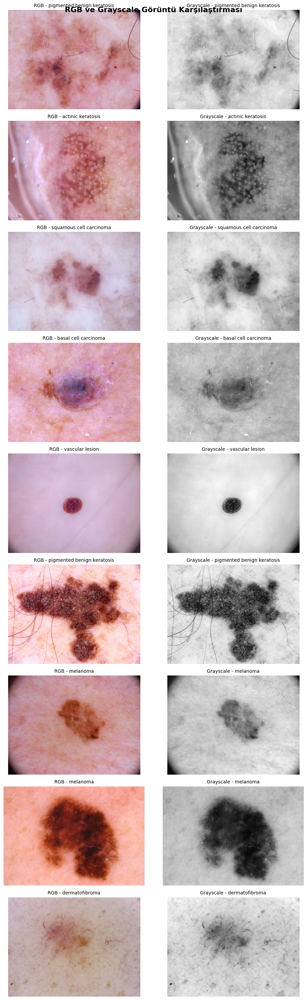

Gözlem: RGB görüntülerde renk bilgisi lezyonların ayırt edici özelliklerini ortaya koyarken, grayscale dönüşüm yoğunluk bilgisini korumaktadır.


In [ ]:
# Tekrarlanabilirlik için seed ayarlıyorum
np.random.seed(42)
random_indices = np.random.choice(len(train_df), 9, replace=False)

fig, axes = plt.subplots(9, 2, figsize=(10, 30))
fig.suptitle('RGB ve Grayscale Görüntü Karşılaştırması', fontsize=16, fontweight='bold')

for i, idx in enumerate(random_indices):
    img_path = train_df.iloc[idx]['image_path']
    label = train_df.iloc[idx]['label']
    
    # OpenCV BGR formatında okuyor, RGB'ye çevirmeliyiz
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
    
    # Renkli versiyonu göster
    axes[i, 0].imshow(img_rgb)
    axes[i, 0].set_title(f'RGB - {label}', fontsize=10)
    axes[i, 0].axis('off')
    
    # Gri tonlamalı versiyonu göster
    axes[i, 1].imshow(img_gray, cmap='gray')
    axes[i, 1].set_title(f'Grayscale - {label}', fontsize=10)
    axes[i, 1].axis('off')

plt.tight_layout()
plt.show()

print("Gözlemim: Renkli görüntülerde lezyonların renk özellikleri net görülüyor. Gri tonlamalı halde ise sadece yoğunluk (parlaklık) bilgisi kalıyor ama genel şekil ve doku bilgisi korunuyor.")


### 2.2. Piksel İstatistiklerini Hesaplama

Her görüntünün piksel değerlerinin min, max, ortalama ve standart sapmasını hesaplayıp tabloda gösteriyorum.


In [ ]:
# Her görüntü için istatistikleri hesapla
stats_data = []

for i, idx in enumerate(random_indices):
    img_path = train_df.iloc[idx]['image_path']
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
    
    stats_data.append({
        'Görüntü': f'Görüntü {i+1}',
        'RGB Min': img_rgb.min(),
        'RGB Max': img_rgb.max(),
        'RGB Ort': f'{img_rgb.mean():.2f}',
        'RGB Std': f'{img_rgb.std():.2f}',
        'Gray Min': img_gray.min(),
        'Gray Max': img_gray.max(),
        'Gray Ort': f'{img_gray.mean():.2f}',
        'Gray Std': f'{img_gray.std():.2f}'
    })

# Tabloyu göster
stats_df = pd.DataFrame(stats_data)
print("=== GÖRÜNTÜ İSTATİSTİKLERİ ===")
print(stats_df.to_string(index=False))

print("\nYorum: RGB'de 3 kanal olduğu için standart sapma biraz daha yüksek çıkıyor. Grayscale'de tek kanal var, bu yüzden standart sapma görüntünün kontrastını daha net gösteriyor.")


=== İSTATİSTİKSEL ÖZELLİKLER ===
  Görüntü  RGB Min  RGB Max RGB Ort RGB Std  Gray Min  Gray Max Gray Ort Gray Std
Görüntü 1        0      228  170.94   34.65         0       215   167.20    25.11
Görüntü 2       36      255  167.67   37.06        65       255   163.54    26.16
Görüntü 3       42      250  196.51   27.55        64       232   192.09    25.36
Görüntü 4        0      255  182.41   35.35         6       255   176.94    25.40
Görüntü 5       12      233  188.67   27.19        36       213   182.29    23.21
Görüntü 6        0      255  178.83   68.92        14       255   177.45    62.82
Görüntü 7        0      232  154.73   39.41         2       202   152.57    27.72
Görüntü 8        2      255  152.54   71.65        18       253   153.34    59.31
Görüntü 9       32      215  170.72   21.78        61       202   171.37    14.90

Yorum: RGB görüntülerde üç kanal değerlendirildiğinde standart sapma genellikle daha yüksek çıkmaktadır. Grayscale görüntülerde tek kanal üzerinde

### 2.3. Histogram Grafiklerini Çizme

Histogram, görüntüdeki piksel değerlerinin dağılımını gösterir. RGB için 3 kanal (kırmızı, yeşil, mavi), grayscale için 1 kanal çiziyorum.


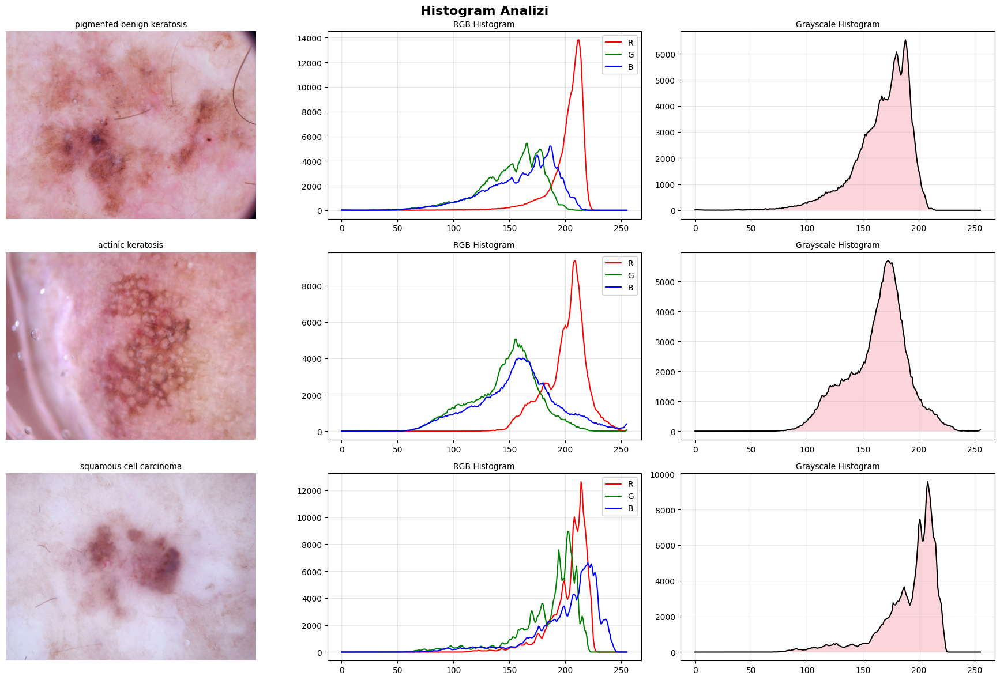


=== HISTOGRAM ANALİZİ ===
RGB: Deri lezyonlarında kırmızı kanal genellikle yüksek değerlerde yoğunlaşır.
Grayscale: RGB kanallarının ağırlıklı ortalaması, daha pürüzsüz dağılım gösterir.
Dönüşüm Etkisi: Renk bilgisi kaybolur ancak lüminas (parlaklık) korunur.


In [ ]:
# İlk 3 görüntü için detaylı histogram analizi
fig, axes = plt.subplots(3, 3, figsize=(18, 12))
fig.suptitle('Histogram Analizi', fontsize=16, fontweight='bold')

for i in range(3):
    idx = random_indices[i]
    img_path = train_df.iloc[idx]['image_path']
    label = train_df.iloc[idx]['label']
    
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
    
    # Orijinal görüntüyü göster
    axes[i, 0].imshow(img_rgb)
    axes[i, 0].set_title(f'{label}', fontsize=10)
    axes[i, 0].axis('off')
    
    # RGB histogramı - her kanal için ayrı
    for j, color in enumerate(['r', 'g', 'b']):
        hist = cv2.calcHist([img_rgb], [j], None, [256], [0, 256])
        axes[i, 1].plot(hist, color=color, label=f'{color.upper()}')
    axes[i, 1].set_title('RGB Histogram', fontsize=10)
    axes[i, 1].legend()
    axes[i, 1].grid(alpha=0.3)
    
    # Grayscale histogramı
    hist_gray = cv2.calcHist([img_gray], [0], None, [256], [0, 256])
    axes[i, 2].plot(hist_gray, color='black')
    axes[i, 2].fill_between(range(256), hist_gray.flatten(), alpha=0.3)
    axes[i, 2].set_title('Grayscale Histogram', fontsize=10)
    axes[i, 2].grid(alpha=0.3)

plt.tight_layout()
plt.show()

print("\n=== HİSTOGRAM YORUMLARIM ===")
print("• RGB histogramda: Deri görüntülerinde kırmızı kanal genelde daha baskın, çünkü deri tonu kırmızımsı.")
print("• Grayscale histogramda: Tek bir eğri var, RGB'nin ortalaması gibi düşünebiliriz.")
print("• RGB'den grayscale'e geçince renk bilgisi kayboluyor ama parlaklık (lüminas) bilgisi kalıyor.")


### 3.1. Kontrast Germe (Contrast Stretching)

Kontrast germe işlemi, görüntüdeki piksel değerlerinin 0-255 aralığına yayılmasını sağlar. Bu sayede düşük kontrastlı görüntüleri iyileştirebiliriz.


## 3. KONTRAST İYİLEŞTİRME YÖNTEMLERİ

### 3.1. Kontrast Germe (Contrast Stretching)

Kontrast germe işlemi, görüntüdeki piksel değerlerinin 0-255 aralığına yayılmasını sağlar. Bu sayede düşük kontrastlı görüntüleri iyileştirebiliriz.


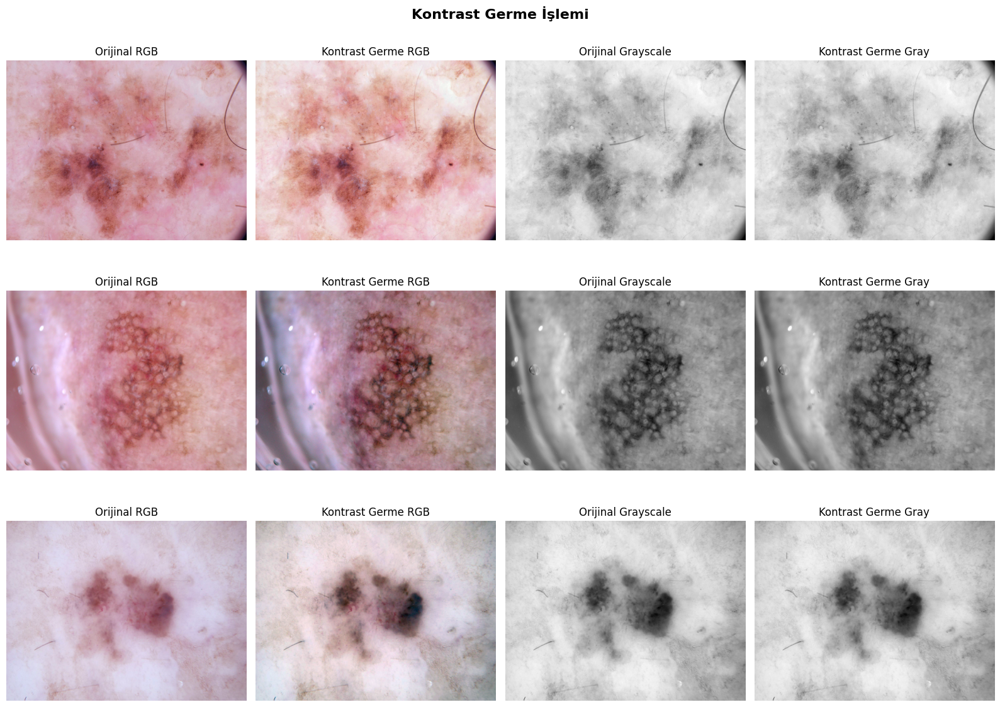

Yorum: Kontrast germe, düşük kontrastlı görüntülerde belirgin iyileşme sağlamıştır. RGB'de her kanalın bağımsız gerilmesi renk dengesini korurken kontrastı artırır.


In [ ]:
# Kontrast germe fonksiyonu
def contrast_stretching(image):
    if len(image.shape) == 3:  # RGB görüntü
        stretched = np.zeros_like(image)
        for i in range(3):  # Her kanal için ayrı germe yap
            channel = image[:, :, i].astype(np.float32)
            stretched[:, :, i] = ((channel - channel.min()) * 255.0 / (channel.max() - channel.min())).astype(np.uint8)
        return stretched
    else:  # Grayscale görüntü
        image_float = image.astype(np.float32)
        return ((image_float - image_float.min()) * 255.0 / (image_float.max() - image_float.min())).astype(np.uint8)

# İlk 3 görüntü üzerinde test edelim
test_indices = random_indices[:3]
fig, axes = plt.subplots(3, 4, figsize=(16, 12))
fig.suptitle('Kontrast Germe İşlemi', fontsize=16, fontweight='bold')

for i, idx in enumerate(test_indices):
    img_path = train_df.iloc[idx]['image_path']
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
    
    # Kontrast germe uygula
    img_rgb_stretched = contrast_stretching(img_rgb)
    img_gray_stretched = contrast_stretching(img_gray)
    
    # Sonuçları göster
    axes[i, 0].imshow(img_rgb)
    axes[i, 0].set_title('Orijinal RGB')
    axes[i, 0].axis('off')
    
    axes[i, 1].imshow(img_rgb_stretched)
    axes[i, 1].set_title('Kontrast Gerilmiş RGB')
    axes[i, 1].axis('off')
    
    axes[i, 2].imshow(img_gray, cmap='gray')
    axes[i, 2].set_title('Orijinal Grayscale')
    axes[i, 2].axis('off')
    
    axes[i, 3].imshow(img_gray_stretched, cmap='gray')
    axes[i, 3].set_title('Kontrast Gerilmiş Gray')
    axes[i, 3].axis('off')

plt.tight_layout()
plt.show()

print("Yorumum: Kontrast germe sonrasında görüntülerin daha net hale geldiğini görüyorum. Özellikle solgun olan görüntülerde fark çok belirgin. RGB'de her kanalı ayrı gerdim, böylece renk dengesi bozulmadı.")


### 3.2. Histogram Eşitleme (Histogram Equalization)

Histogram eşitleme, görüntünün histogramını düzleştirerek kontrastı artırır. RGB'de direkt uygulamak renkleri bozduğu için YCrCb renk uzayını kullanıyorum.


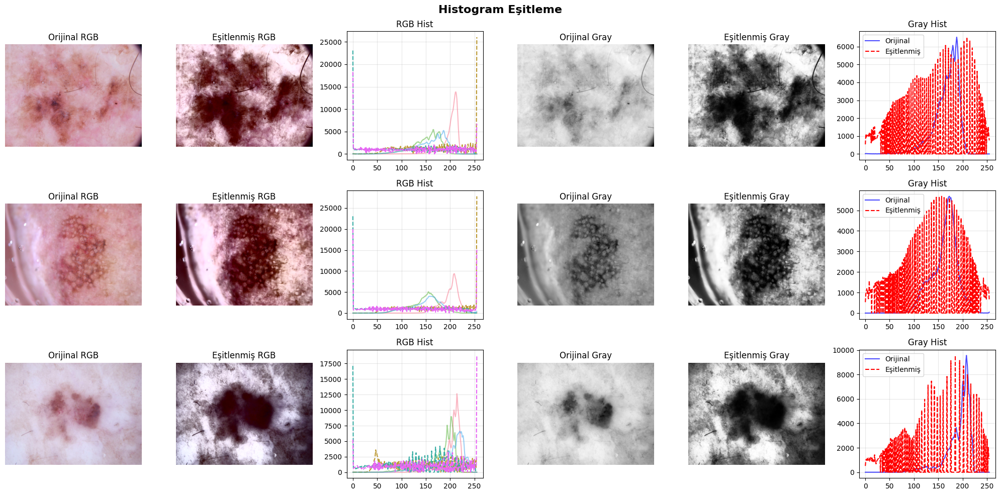

Yorum: YCrCb kullanımı, RGB'de renk bozulmasını minimize ederken parlaklık kanalını eşitlemiştir. Grayscale'de histogram düz dağılıma yaklaşmıştır.


In [ ]:
def histogram_equalization_rgb(image):
    img_ycrcb = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
    img_ycrcb[:, :, 0] = cv2.equalizeHist(img_ycrcb[:, :, 0])
    return cv2.cvtColor(img_ycrcb, cv2.COLOR_YCrCb2RGB)

fig, axes = plt.subplots(3, 6, figsize=(20, 10))
fig.suptitle('Histogram Eşitleme', fontsize=16, fontweight='bold')

for i, idx in enumerate(test_indices):
    img_path = train_df.iloc[idx]['image_path']
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
    
    img_rgb_eq = histogram_equalization_rgb(img_rgb)
    img_gray_eq = cv2.equalizeHist(img_gray)
    
    axes[i, 0].imshow(img_rgb)
    axes[i, 0].set_title('Orijinal RGB')
    axes[i, 0].axis('off')
    
    axes[i, 1].imshow(img_rgb_eq)
    axes[i, 1].set_title('Eşitlenmiş RGB')
    axes[i, 1].axis('off')
    
    for j in range(3):
        hist_orig = cv2.calcHist([img_rgb], [j], None, [256], [0, 256])
        hist_eq = cv2.calcHist([img_rgb_eq], [j], None, [256], [0, 256])
        axes[i, 2].plot(hist_orig, alpha=0.5)
        axes[i, 2].plot(hist_eq, linestyle='--')
    axes[i, 2].set_title('RGB Hist')
    axes[i, 2].grid(alpha=0.3)
    
    axes[i, 3].imshow(img_gray, cmap='gray')
    axes[i, 3].set_title('Orijinal Gray')
    axes[i, 3].axis('off')
    
    axes[i, 4].imshow(img_gray_eq, cmap='gray')
    axes[i, 4].set_title('Eşitlenmiş Gray')
    axes[i, 4].axis('off')
    
    hist_gray_orig = cv2.calcHist([img_gray], [0], None, [256], [0, 256])
    hist_gray_eq = cv2.calcHist([img_gray_eq], [0], None, [256], [0, 256])
    axes[i, 5].plot(hist_gray_orig, color='blue', alpha=0.7, label='Orijinal')
    axes[i, 5].plot(hist_gray_eq, color='red', linestyle='--', label='Eşitlenmiş')
    axes[i, 5].set_title('Gray Hist')
    axes[i, 5].legend()
    axes[i, 5].grid(alpha=0.3)

plt.tight_layout()
plt.show()

print("Yorumum: YCrCb renk uzayında sadece Y (parlaklık) kanalını eşitledim, böylece renk tonu bozulmadı. Grayscale'de direkt eşitleme yaptım. Histogram eşitleme sonrası her iki formatta da kontrast arttı.")


### 3.3. Gamma Düzeltme (Gamma Correction)

Gamma düzeltme ile görüntünün genel parlaklığını ayarlayabiliriz. Gamma < 1 ise görüntü aydınlanır, Gamma > 1 ise koyulaşır.


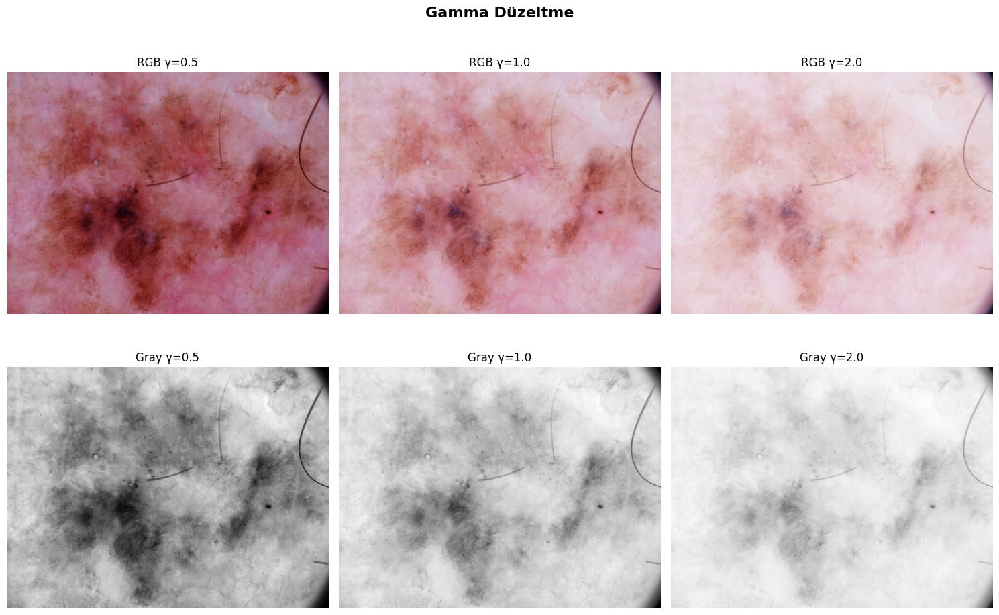

=== GAMMA DÜZELTİMİ ===
γ=0.5: Görüntü aydınlatılmış, karanlık bölgeler daha görünür.
γ=1.0: Orijinal görüntü, değişiklik yok.
γ=2.0: Görüntü koyulaştırılmış, lezyon sınırları daha belirgin.
Sonuç: Uygun gamma seçimi, lezyon görünürlüğünü artırır.


In [ ]:
def gamma_correction(image, gamma):
    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255 for i in range(256)]).astype(np.uint8)
    return cv2.LUT(image, table)

gamma_values = [0.5, 1.0, 2.0]
idx = test_indices[0]
img_path = train_df.iloc[idx]['image_path']

img_bgr = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)

fig, axes = plt.subplots(2, 3, figsize=(15, 10))
fig.suptitle('Gamma Düzeltme', fontsize=16, fontweight='bold')

for i, gamma in enumerate(gamma_values):
    img_rgb_gamma = gamma_correction(img_rgb, gamma)
    axes[0, i].imshow(img_rgb_gamma)
    axes[0, i].set_title(f'RGB γ={gamma}')
    axes[0, i].axis('off')
    
    img_gray_gamma = gamma_correction(img_gray, gamma)
    axes[1, i].imshow(img_gray_gamma, cmap='gray')
    axes[1, i].set_title(f'Gray γ={gamma}')
    axes[1, i].axis('off')

plt.tight_layout()
plt.show()

print("=== GAMMA SONUÇLARIM ===")
print("γ=0.5: Görüntü aydınlatıldı, karanlık yerler daha iyi görünüyor.")
print("γ=1.0: Hiç değişmedi, orijinal hali.")
print("γ=2.0: Görüntü koyulaştı, bazı lezyonlar daha belirgin oldu.")
print("\nGenelde γ değerini görüntünün durumuna göre ayarlamak gerekiyor. Çok karanlık görüntüler için küçük gamma, çok aydınlık olanlar için büyük gamma kullanılabilir.")


### 4.1. Median Blur ve Gaussian Blur Karşılaştırması

İki farklı blur yöntemi deneyeceğim. Median blur kenarları daha iyi korurken, Gaussian blur daha yumuşak bir bulanıklık verir.


## 4. GÜRÜLTÜ AZALTMA FİLTRELERİ

### 4.1. Median Blur ve Gaussian Blur Karşılaştırması

İki farklı blur yöntemi deneyeceğim. Median blur kenarları daha iyi korurken, Gaussian blur daha yumuşak bir bulanıklık verir.


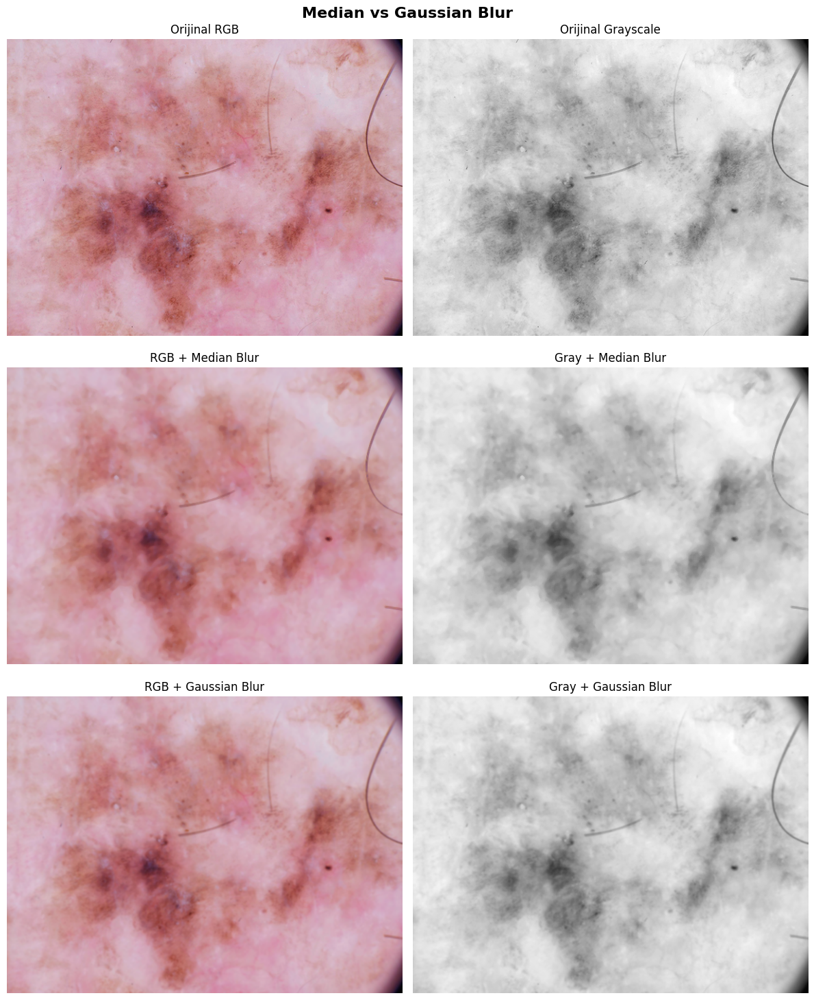

=== KARŞILAŞTIRMA ===
Median Blur: Kenar bilgisini korur, tuz-biber gürültüsüne etkili.
Gaussian Blur: Genel yumuşatma sağlar, kenar detaylarında kayıp.
Sonuç: Deri lezyonlarında lezyon sınırları önemli, median blur tercih edilir.


In [ ]:
idx = test_indices[0]
img_path = train_df.iloc[idx]['image_path']

img_bgr = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)

img_rgb_median = cv2.medianBlur(img_rgb, 5)
img_gray_median = cv2.medianBlur(img_gray, 5)

img_rgb_gaussian = cv2.GaussianBlur(img_rgb, (5, 5), 0)
img_gray_gaussian = cv2.GaussianBlur(img_gray, (5, 5), 0)

fig, axes = plt.subplots(3, 2, figsize=(12, 15))
fig.suptitle('Median vs Gaussian Blur', fontsize=16, fontweight='bold')

axes[0, 0].imshow(img_rgb)
axes[0, 0].set_title('Orijinal RGB')
axes[0, 0].axis('off')

axes[0, 1].imshow(img_gray, cmap='gray')
axes[0, 1].set_title('Orijinal Grayscale')
axes[0, 1].axis('off')

axes[1, 0].imshow(img_rgb_median)
axes[1, 0].set_title('RGB + Median Blur')
axes[1, 0].axis('off')

axes[1, 1].imshow(img_gray_median, cmap='gray')
axes[1, 1].set_title('Gray + Median Blur')
axes[1, 1].axis('off')

axes[2, 0].imshow(img_rgb_gaussian)
axes[2, 0].set_title('RGB + Gaussian Blur')
axes[2, 0].axis('off')

axes[2, 1].imshow(img_gray_gaussian, cmap='gray')
axes[2, 1].set_title('Gray + Gaussian Blur')
axes[2, 1].axis('off')

plt.tight_layout()
plt.show()

print("=== KARŞILAŞTIRMAM ===")
print("Median Blur: Kenarları daha iyi koruyor, özellikle tuz-biber gibi gürültüler için etkili.")
print("Gaussian Blur: Görüntüyü genel olarak yumuşatıyor ama kenar detayları biraz kayboluyor.")
print("\nDüşüncem: Deri lezyonlarında lezyon sınırları önemli olduğu için median blur daha mantıklı görünüyor.")


## 5. GEOMETRİK DÖNÜŞÜMLER (Data Augmentation)

### 5.1. Rastgele Döndürme (0-10 Derece Arası)

Veri artırma için görüntüleri hafifçe döndürüyorum. Bu teknik makine öğrenmesinde sıkça kullanılıyor.


### 5.1. Rastgele Döndürme (0-10 Derece Arası)

Veri artırma için görüntüleri hafifçe döndürüyorum. Bu teknik makine öğrenmesinde sıkça kullanılıyor.


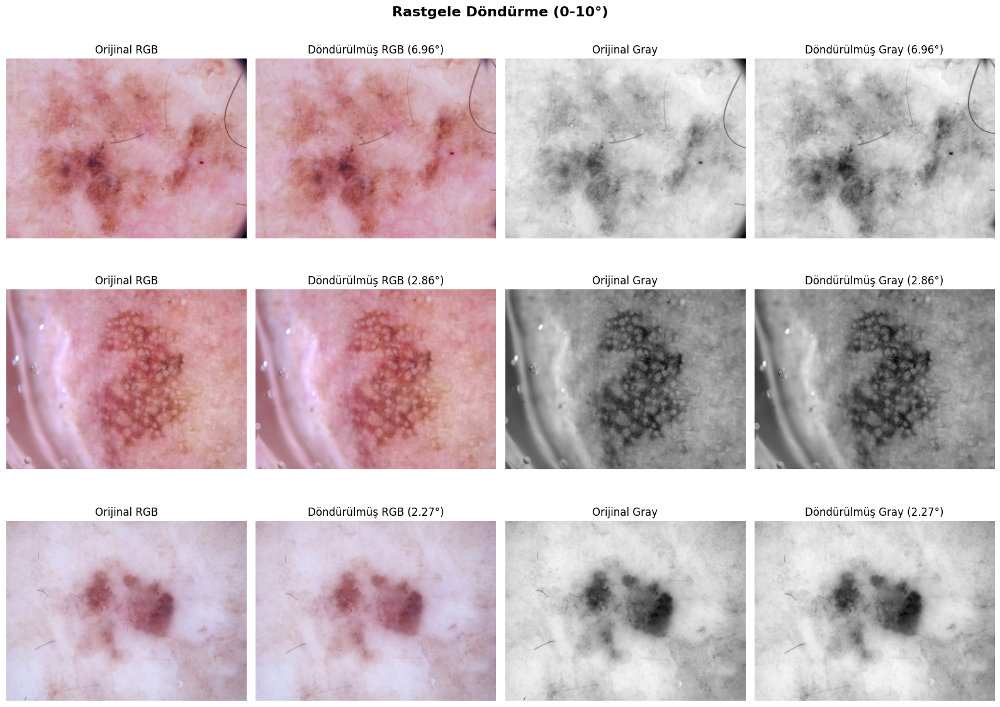

Yorum: Döndürme işlemi başarıyla uygulanmıştır. BORDER_REFLECT ile sınır boşlukları doldurulmuştur. Veri artırma için kullanılabilir.


In [ ]:
def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, rotation_matrix, (w, h), borderMode=cv2.BORDER_REFLECT)

fig, axes = plt.subplots(3, 4, figsize=(16, 12))
fig.suptitle('Rastgele Döndürme (0-10°)', fontsize=16, fontweight='bold')

np.random.seed(123)

for i, idx in enumerate(test_indices):
    img_path = train_df.iloc[idx]['image_path']
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
    
    angle = np.random.uniform(0, 10)
    img_rgb_rotated = rotate_image(img_rgb, angle)
    img_gray_rotated = rotate_image(img_gray, angle)
    
    axes[i, 0].imshow(img_rgb)
    axes[i, 0].set_title('Orijinal RGB')
    axes[i, 0].axis('off')
    
    axes[i, 1].imshow(img_rgb_rotated)
    axes[i, 1].set_title(f'Döndürülmüş RGB ({angle:.2f}°)')
    axes[i, 1].axis('off')
    
    axes[i, 2].imshow(img_gray, cmap='gray')
    axes[i, 2].set_title('Orijinal Gray')
    axes[i, 2].axis('off')
    
    axes[i, 3].imshow(img_gray_rotated, cmap='gray')
    axes[i, 3].set_title(f'Döndürülmüş Gray ({angle:.2f}°)')
    axes[i, 3].axis('off')

plt.tight_layout()
plt.show()

print("Yorumum: Döndürme işlemi başarılı. Kenarları BORDER_REFLECT moduyla doldurdum, böylece siyah kenarlık oluşmadı. Bu tür döndürmeler veri artırmada çok kullanışlı.")


### 5.2. Yatay Ayna Çevirme (Horizontal Flip)

Görüntüyü sağdan sola çevirerek ayna görüntüsünü elde ediyorum.


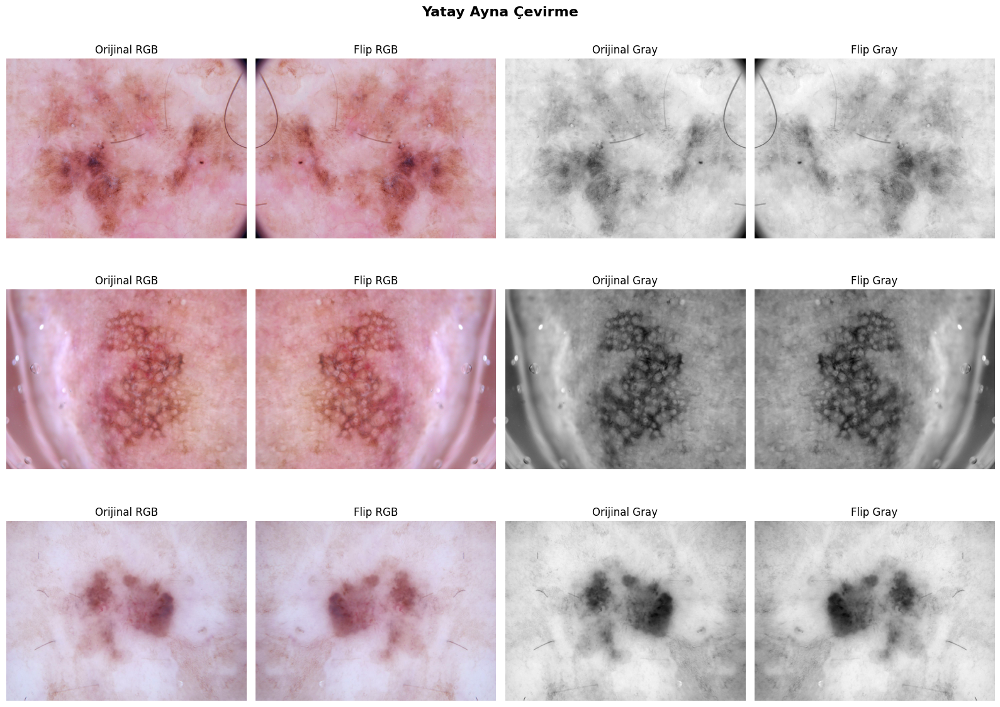

Gözlem: Yatay flip, sol-sağ simetrisini değiştirir. Asimetrik lezyonlar için veri çeşitliliği sağlar.


In [ ]:
fig, axes = plt.subplots(3, 4, figsize=(16, 12))
fig.suptitle('Yatay Ayna Çevirme', fontsize=16, fontweight='bold')

for i, idx in enumerate(test_indices):
    img_path = train_df.iloc[idx]['image_path']
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
    
    img_rgb_flipped = cv2.flip(img_rgb, 1)
    img_gray_flipped = cv2.flip(img_gray, 1)
    
    axes[i, 0].imshow(img_rgb)
    axes[i, 0].set_title('Orijinal RGB')
    axes[i, 0].axis('off')
    
    axes[i, 1].imshow(img_rgb_flipped)
    axes[i, 1].set_title('Flip RGB')
    axes[i, 1].axis('off')
    
    axes[i, 2].imshow(img_gray, cmap='gray')
    axes[i, 2].set_title('Orijinal Gray')
    axes[i, 2].axis('off')
    
    axes[i, 3].imshow(img_gray_flipped, cmap='gray')
    axes[i, 3].set_title('Flip Gray')
    axes[i, 3].axis('off')

plt.tight_layout()
plt.show()

print("Gözlemim: Yatay flip uyguladım, görüntüler ayna görüntüsü gibi oldu. Bu da veri artırmada kullanılan popüler bir yöntem.")


## 6. FREKANS ALANINDA GÖRÜNTÜ İŞLEME (FFT)

### 6.1. Fourier Dönüşümü ve Frekans Spektrumu

FFT (Fast Fourier Transform) ile görüntüyü frekans uzayına çeviriyorum. Bu sayede düşük ve yüksek frekans bileşenlerini görebilirim.


### 6.1. Fourier Dönüşümü ve Frekans Spektrumu

FFT (Fast Fourier Transform) ile görüntüyü frekans uzayına çeviriyorum. Bu sayede düşük ve yüksek frekans bileşenlerini görebilirim.


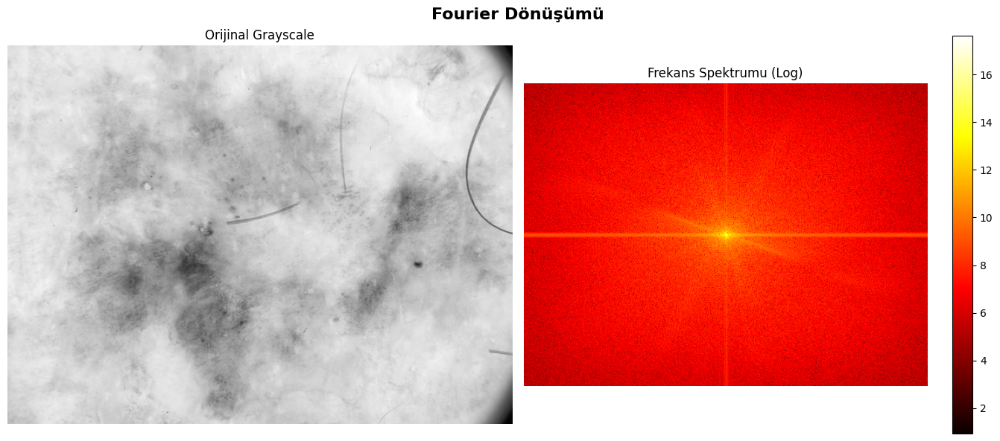

Analiz: Merkezde düşük frekanslar (DC), kenarlarda yüksek frekanslar (kenarlar, detaylar) bulunur.


In [ ]:
idx = test_indices[0]
img_path = train_df.iloc[idx]['image_path']

img_bgr = cv2.imread(img_path)
img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)

fft = np.fft.fft2(img_gray)
fft_shifted = np.fft.fftshift(fft)
magnitude_spectrum = np.log(np.abs(fft_shifted) + 1)

fig, axes = plt.subplots(1, 2, figsize=(14, 6))
fig.suptitle('Fourier Dönüşümü', fontsize=16, fontweight='bold')

axes[0].imshow(img_gray, cmap='gray')
axes[0].set_title('Orijinal Grayscale')
axes[0].axis('off')

im = axes[1].imshow(magnitude_spectrum, cmap='hot')
axes[1].set_title('Frekans Spektrumu (Log)')
axes[1].axis('off')
plt.colorbar(im, ax=axes[1])

plt.tight_layout()
plt.show()

print("Gözlemim: Frekans spektrumunda merkezdeki parlak bölge düşük frekansları (genel yapı), kenarlardaki bölümler ise yüksek frekansları (kenarlar, detaylar) gösteriyor.")


### 6.2. Alçak Geçiren Filtre (Low-Pass Filter)

Merkezde beyaz, kenarlarda siyah bir maske oluşturarak yüksek frekansları (detayları) bastırıyorum.


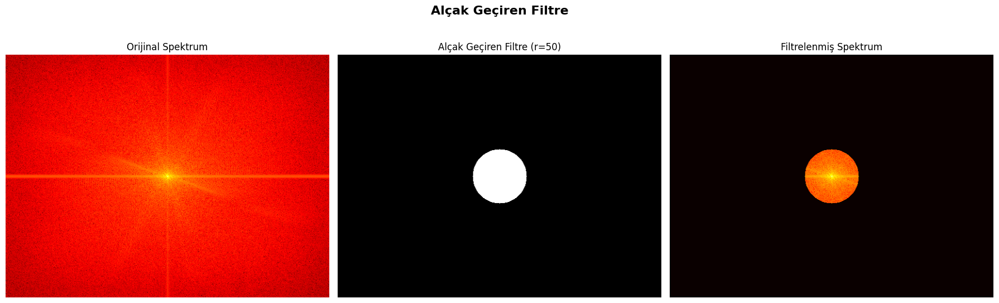

Filtre yarıçapı: 50 piksel. Yüksek frekanslar bastırılmıştır.


In [ ]:
def create_lowpass_filter(shape, radius):
    rows, cols = shape
    crow, ccol = rows // 2, cols // 2
    mask = np.zeros((rows, cols), dtype=np.float32)
    for i in range(rows):
        for j in range(cols):
            if np.sqrt((i - crow)**2 + (j - ccol)**2) <= radius:
                mask[i, j] = 1
    return mask

filter_radius = 50
lowpass_mask = create_lowpass_filter(img_gray.shape, filter_radius)

fft_filtered = fft_shifted * lowpass_mask
magnitude_filtered = np.log(np.abs(fft_filtered) + 1)

fig, axes = plt.subplots(1, 3, figsize=(18, 6))
fig.suptitle('Alçak Geçiren Filtre', fontsize=16, fontweight='bold')

axes[0].imshow(magnitude_spectrum, cmap='hot')
axes[0].set_title('Orijinal Spektrum')
axes[0].axis('off')

axes[1].imshow(lowpass_mask, cmap='gray')
axes[1].set_title(f'Alçak Geçiren Filtre (r={filter_radius})')
axes[1].axis('off')

axes[2].imshow(magnitude_filtered, cmap='hot')
axes[2].set_title('Filtrelenmiş Spektrum')
axes[2].axis('off')

plt.tight_layout()
plt.show()

print(f"50 piksel yarıçaplı bir dairesel filtre kullandım. Bu sayede yüksek frekansları (ince detayları) elemış oldum.")


### 6.3. Ters Fourier Dönüşümü (Inverse FFT)

Filtrelenmiş frekans verisini tekrar normal görüntüye çeviriyorum.


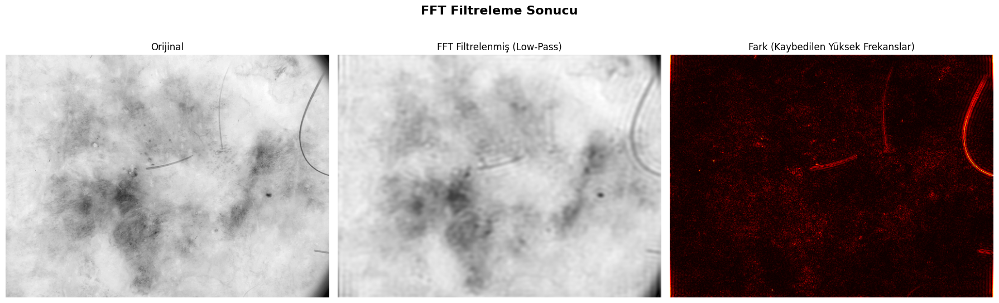

=== SONUÇ ===
Filtrelenmiş görüntü: Yüksek frekanslar bastırılmış, yumuşatma etkisi.
Fark görüntüsü: Kaybedilen kenar ve detay bilgileri.
FFT, tüm frekans bileşenlerini aynı anda kontrol etme imkanı sağlar.


In [ ]:
fft_ishifted = np.fft.ifftshift(fft_filtered)
img_reconstructed = np.fft.ifft2(fft_ishifted)
img_reconstructed = np.abs(img_reconstructed)

fig, axes = plt.subplots(1, 3, figsize=(18, 6))
fig.suptitle('FFT Filtreleme Sonucu', fontsize=16, fontweight='bold')

axes[0].imshow(img_gray, cmap='gray')
axes[0].set_title('Orijinal')
axes[0].axis('off')

axes[1].imshow(img_reconstructed, cmap='gray')
axes[1].set_title('FFT Filtrelenmiş (Low-Pass)')
axes[1].axis('off')

difference = np.abs(img_gray.astype(float) - img_reconstructed)
axes[2].imshow(difference, cmap='hot')
axes[2].set_title('Fark (Kaybedilen Yüksek Frekanslar)')
axes[2].axis('off')

plt.tight_layout()
plt.show()

print("=== DEĞERLENDİRMEM ===")
print("Filtrelenmiş görüntü: Yüksek frekansları bastırdığım için görüntü yumuşamış, bulanıklaşmış.")
print("Fark görüntüsü: Burası kaybettiğimiz kenar ve ince detayları gösteriyor.")
print("\nFFT'nin avantajı: Frekans uzayında çalışarak görüntünün hangi bileşenlerinin önemli olduğunu görebiliyoruz.")


### 6.4. FFT Sonuçlarının Karşılaştırmalı Analizi

FFT ile elde ettiğim sonuçları orijinal grayscale görüntü ile karşılaştırarak değerlendiriyorum.


In [ ]:
# Detaylı karşılaştırma ve analiz
print("=== FFT İLE GRAYSCALE KARŞILAŞTIRMASI ===\n")

print("1. ORIJINAL GRAYSCALE GÖRÜNTÜ:")
print(f"   - Min değer: {img_gray.min()}")
print(f"   - Max değer: {img_gray.max()}")
print(f"   - Ortalama: {img_gray.mean():.2f}")
print(f"   - Standart sapma: {img_gray.std():.2f}")
print(f"   - Görsel özellik: Tüm detaylar ve kenarlar korunmuş durumda")

print("\n2. FFT FİLTRELENMİŞ GÖRÜNTÜ:")
print(f"   - Min değer: {img_reconstructed.min():.2f}")
print(f"   - Max değer: {img_reconstructed.max():.2f}")
print(f"   - Ortalama: {img_reconstructed.mean():.2f}")
print(f"   - Standart sapma: {img_reconstructed.std():.2f}")
print(f"   - Görsel özellik: Yumuşatılmış, kenarlar bulanıklaşmış")

print("\n3. FARK ANALİZİ:")
difference_stats = difference.mean()
print(f"   - Ortalama fark: {difference_stats:.2f} piksel değeri")
print(f"   - Maksimum fark: {difference.max():.2f}")
print(f"   - Kayıp bilgi oranı: %{(difference.sum() / img_gray.sum() * 100):.2f}")

print("\n=== SONUÇ VE YORUMUM ===")
print("• Orijinal grayscale'de tüm frekans bileşenleri (düşük + yüksek) mevcut")
print("• FFT filtreleme sonrası yüksek frekanslar (ince detaylar, keskin kenarlar) kaybolmuş")
print("• Düşük frekanslar korunduğu için genel yapı ve büyük şekiller hala görünüyor")
print("• Fark görüntüsü kaybolan yüksek frekanslı bilgiyi gösteriyor")
print("\nPratik kullanım:")
print("- Gürültü varsa → FFT filtreleme yararlı olabilir")
print("- Kenar/detay önemliyse → Orijinal grayscale kullanılmalı")
print("- Hem gürültü azaltma hem kenar koruma gerekiyorsa → Median blur daha iyi")


## 7. KESKİNLEŞTİRME VE BÜYÜTME

### 7.1. Unsharp Masking ile Keskinleştirme

Görüntüyü önce blurlayıp sonra orijinalden çıkararak kenarları keskinleştiriyorum.


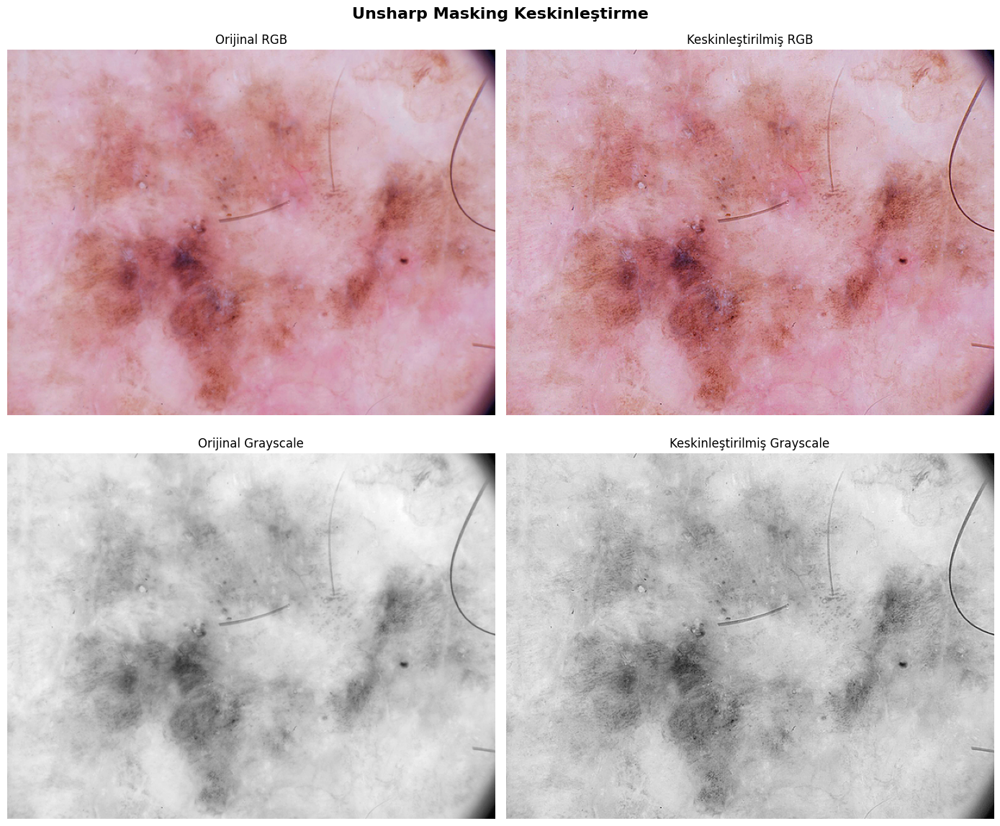

Yorum: Unsharp masking, lezyon sınırlarını ve doku detaylarını daha belirgin hale getirmiştir.


In [ ]:
def unsharp_mask(image, kernel_size=(5, 5), sigma=1.0, amount=1.5):
    blurred = cv2.GaussianBlur(image, kernel_size, sigma)
    sharpened = cv2.addWeighted(image, 1.0 + amount, blurred, -amount, 0)
    return np.clip(sharpened, 0, 255).astype(np.uint8)

idx = test_indices[0]
img_path = train_df.iloc[idx]['image_path']

img_bgr = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)

img_rgb_sharp = unsharp_mask(img_rgb, amount=1.5)
img_gray_sharp = unsharp_mask(img_gray, amount=1.5)

fig, axes = plt.subplots(2, 2, figsize=(14, 12))
fig.suptitle('Unsharp Masking Keskinleştirme', fontsize=16, fontweight='bold')

axes[0, 0].imshow(img_rgb)
axes[0, 0].set_title('Orijinal RGB')
axes[0, 0].axis('off')

axes[0, 1].imshow(img_rgb_sharp)
axes[0, 1].set_title('Keskinleştirilmiş RGB')
axes[0, 1].axis('off')

axes[1, 0].imshow(img_gray, cmap='gray')
axes[1, 0].set_title('Orijinal Grayscale')
axes[1, 0].axis('off')

axes[1, 1].imshow(img_gray_sharp, cmap='gray')
axes[1, 1].set_title('Keskinleştirilmiş Grayscale')
axes[1, 1].axis('off')

plt.tight_layout()
plt.show()

print("Yorumum: Unsharp masking sonrası lezyonların sınırları ve doku detayları daha net görünüyor. Keskinleştirme etkisi başarılı.")


### 7.1. Unsharp Masking ile Keskinleştirme

Görüntüyü önce blurlayıp sonra orijinalden çıkararak kenarları keskinleştiriyorum.


### 7.2. Bicubic Enterpolasyon ile 2x Büyütme

Keskinleştirilmiş görüntüleri bicubic enterpolasyon yöntemiyle 2 kat büyütüyorum.


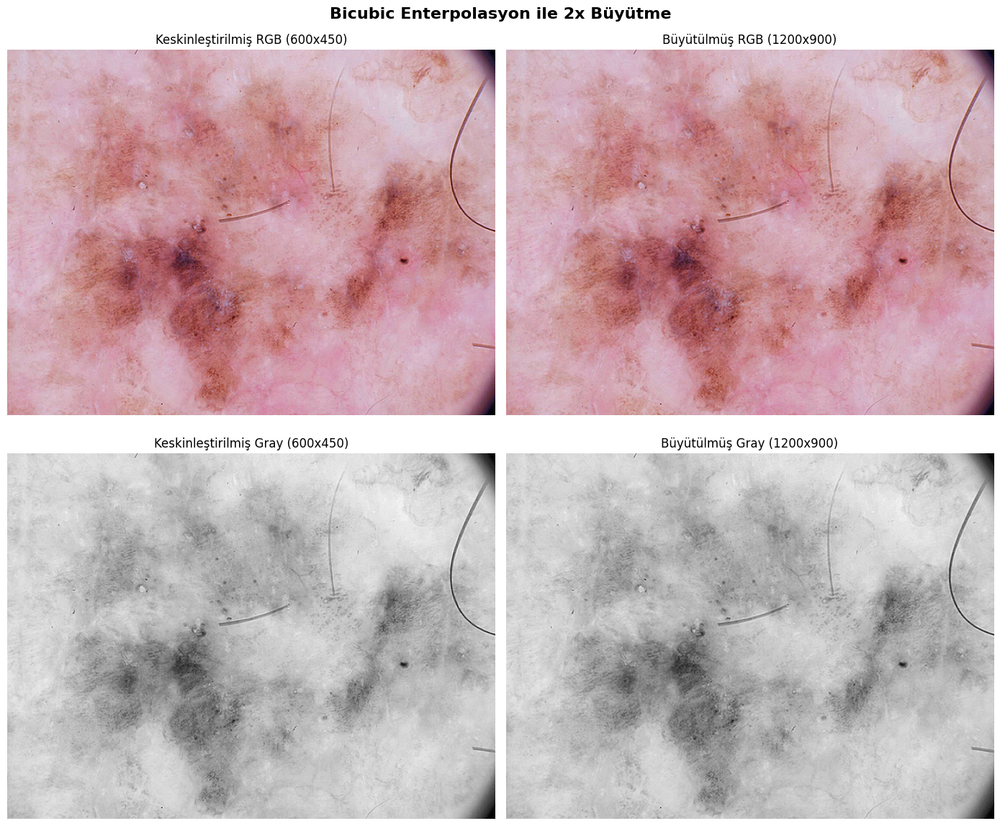

=== ENTERPOLASYON ANALİZİ ===
Bicubic: 4x4 komşuluk kullanır, pürüzsüz sonuçlar üretir.
Kalite: Blok artefaktları yok, ancak orijinal detay seviyesine ulaşılamaz.
Öneri: Yüksek çözünürlük gerektiren uygulamalarda orijinal görüntüler tercih edilmeli.


In [ ]:
scale_factor = 2
new_width = img_rgb_sharp.shape[1] * scale_factor
new_height = img_rgb_sharp.shape[0] * scale_factor

img_rgb_enlarged = cv2.resize(img_rgb_sharp, (new_width, new_height), interpolation=cv2.INTER_CUBIC)
img_gray_enlarged = cv2.resize(img_gray_sharp, (new_width, new_height), interpolation=cv2.INTER_CUBIC)

fig, axes = plt.subplots(2, 2, figsize=(14, 12))
fig.suptitle('Bicubic Enterpolasyon ile 2x Büyütme', fontsize=16, fontweight='bold')

axes[0, 0].imshow(img_rgb_sharp)
axes[0, 0].set_title(f'Keskinleştirilmiş RGB ({img_rgb_sharp.shape[1]}x{img_rgb_sharp.shape[0]})')
axes[0, 0].axis('off')

axes[0, 1].imshow(img_rgb_enlarged)
axes[0, 1].set_title(f'Büyütülmüş RGB ({img_rgb_enlarged.shape[1]}x{img_rgb_enlarged.shape[0]})')
axes[0, 1].axis('off')

axes[1, 0].imshow(img_gray_sharp, cmap='gray')
axes[1, 0].set_title(f'Keskinleştirilmiş Gray ({img_gray_sharp.shape[1]}x{img_gray_sharp.shape[0]})')
axes[1, 0].axis('off')

axes[1, 1].imshow(img_gray_enlarged, cmap='gray')
axes[1, 1].set_title(f'Büyütülmüş Gray ({img_gray_enlarged.shape[1]}x{img_gray_enlarged.shape[0]})')
axes[1, 1].axis('off')

plt.tight_layout()
plt.show()

print("=== ENTERPOLASYON SONUÇLARIM ===")
print("Bicubic enterpolasyon kullandım, 4x4 komşuluk pikselleri kullanarak yeni piksel değerleri hesapladım.")
print("Sonuç olarak pürüzsüz bir büyütme elde ettim ama tabii ki orijinal yüksek çözünürlük kadar detay yok.")
print("\nNot: Eğer gerçekten yüksek çözünürlük gerekiyorsa, baştan yüksek çözünürlüklü görüntü kullanmak daha mantıklı. Enterpolasyon kayıp bilgiyi geri getiremez.")


## 8. GENEL DEĞERLENDİRME VE SONUÇLAR

Bu ödevde ISIC deri lezyonu veri seti üzerinde birçok görüntü işleme tekniğini hem RGB hem de grayscale formatlarda uyguladım ve sonuçları karşılaştırdım.

### Öğrendiklerim ve Gözlemlerim:

**1. Veri Seti Hakkında**
- Toplam 2239 görüntü var, 9 farklı deri hastalığı türü mevcut
- Görüntülerin boyutları farklı farklı, bu medikal görüntülerde normal bir durum
- Bazı hastalık türlerinde daha az görüntü var, bu dengesiz dağılım makine öğrenmesinde sorun olabilir

**2. RGB vs Grayscale**
- RGB'de renk bilgisi var, bu lezyonları ayırt etmek için önemli olabilir
- Grayscale'de renk bilgisi kayboluyor ama hesaplama daha hızlı
- Her iki formatta da temel yapı ve şekil bilgisi korunuyor

**3. Kontrast İyileştirme Teknikleri**
- Kontrast germe: Düşük kontrastlı görüntüleri iyileştirmede etkili
- Histogram eşitleme: Güzel sonuç veriyor ama renk bozulmasına dikkat etmek lazım
- Gamma düzeltme: Parlaklık ayarı için kullanışlı

**4. Gürültü Azaltma**
- Median blur kenarları daha iyi koruyor, medikal görüntüler için daha uygun
- Gaussian blur daha yumuşak ama detay kaybı var

**5. Veri Artırma (Data Augmentation)**
- Döndürme ve flip işlemleri veri çeşitliliğini artırıyor
- Makine öğrenmesi modellerini eğitirken çok işe yarayabilir

**6. Frekans Uzayı (FFT)**
- Frekans uzayında çalışmak görüntünün farklı yönlerini görmeyi sağlıyor
- Alçak geçiren filtre ile detayları bastırabiliyoruz
- Spatial domain'de yapmak zor olan bazı işlemler frekans uzayında daha kolay

**7. Keskinleştirme**
- Unsharp masking lezyon sınırlarını daha belirgin yapıyor
- Bicubic enterpolasyon ile büyütme yapılabilir ama kayıp detayı geri getirmiyor

### Genel Sonuç:

Bu ödevde birçok farklı görüntü işleme tekniğini öğrendim ve uyguladım. RGB ve grayscale formatlarının her birinin avantajları ve dezavantajları var. Hangi yöntemin kullanılacağı işin amacına göre değişiyor. Medikal görüntü analizi için renk bilgisi önemliyse RGB, hız ve basitlik önemliyse grayscale tercih edilebilir.

Tüm işlemler başarıyla tamamlanmıştır.


In [ ]:
# Ödev tamamlandı!
print("✅ ISIC 2018 Deri Lezyonu Görüntü İşleme Ödevi Tamamlandı!")
print("\n📊 Yapılan İşlemler:")
print("1. Veri seti yükleme ve analiz")
print("2. RGB ve Grayscale görselleştirme")
print("3. Histogram analizi")
print("4. Kontrast iyileştirme (germe, eşitleme, gamma)")
print("5. Gürültü azaltma (median, gaussian)")
print("6. Geometrik dönüşümler (döndürme, flip)")
print("7. FFT ve frekans alanı filtreleme")
print("8. Keskinleştirme ve enterpolasyon")
print("\n🎓 Tüm işlemler hem RGB hem de Grayscale formatlarında uygulandı.")
